# imports

In [1]:
cd ..

C:\img_proc_2023


In [2]:
import numpy as np
import rasterio

from matplotlib import pyplot as plt
from matplotlib.colors import LinearSegmentedColormap

import re
from pathlib import Path
from importlib import reload

from PIL import Image
from PIL.ImageOps import equalize
from sklearn.cluster import KMeans
from sklearn.preprocessing import MinMaxScaler
from sklearn.ensemble import RandomForestClassifier

# Read image

In [3]:
ad = 'sentinel_im/sent_stack.tiff'

with rasterio.open(ad) as src:
    ar = src.read()
    key_bands = src.descriptions

print(f'Bands order in stack:\n\t{key_bands}')

ar.shape

Bands order in stack:
	('B02', 'B03', 'B04', 'B05', 'B06', 'B07', 'B08', 'B8A', 'B11', 'B12')


(10, 2152, 2151)

## Transpose img

>- from [bands, rows, cols]
>- to [rows, cols, bands]

In [4]:
ar = np.transpose(ar, (1, 2, 0))
ar.shape

(2152, 2151, 10)

## min_max

$$X_{std} = (X - X_{min}) / (X_{max} - X_{min})$$

$$X_{scaled} = X_{std} * (max - min) + min$$

`from sklearn.preprocessing import MinMaxScaler`:
>- to table data:
col1, col2, col3, ....
>- where col{i} - feature: hight, weight, color, bands, etc
>- image is not tabel

In [5]:
def min_max_scale(ar, min_val=0, max_val=1):
    res = np.zeros_like(ar, dtype=np.float32)
    
    for i in range(ar.shape[-1]):
        band = ar[..., i].copy()
        scale = (band - band.min()) / (band.max() - band.min())
        res[..., i] = scale
    
    res = res * (max_val - min_val) + min_val
    return res

In [6]:
ars = min_max_scale(ar, max_val=255).astype(np.uint8)
ars.shape

(2152, 2151, 10)

## Show rgb

> key_bands:
>- red:   'B04'
>- green: 'B03'
>- blue:  'B02'

In [7]:
# rgb
idx_rgb = [key_bands.index(name) for name in ('B04', 'B03', 'B02')]
idx_rgb

[2, 1, 0]

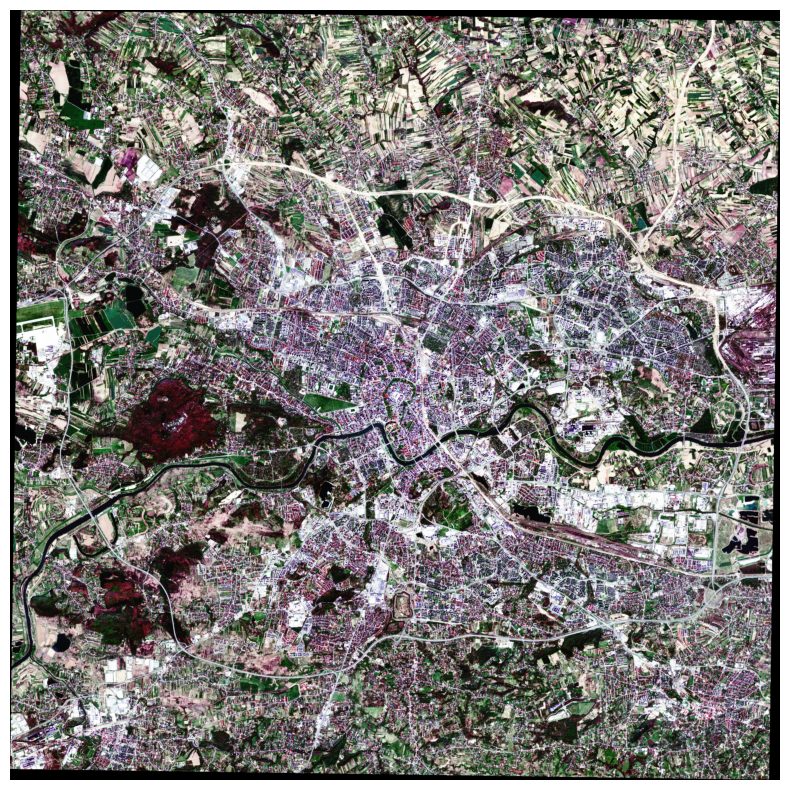

In [8]:
rgb = Image.fromarray(ars[:, :, idx_rgb])
rgb = equalize(rgb)

f = plt.figure(figsize=(10,10))
plt.imshow(rgb);
plt.axis('off');

## Show fcc
> bands:
>- 'B08'
>- red: 'B04'
>- green: 'B03'

bands idx: [6, 2, 1]



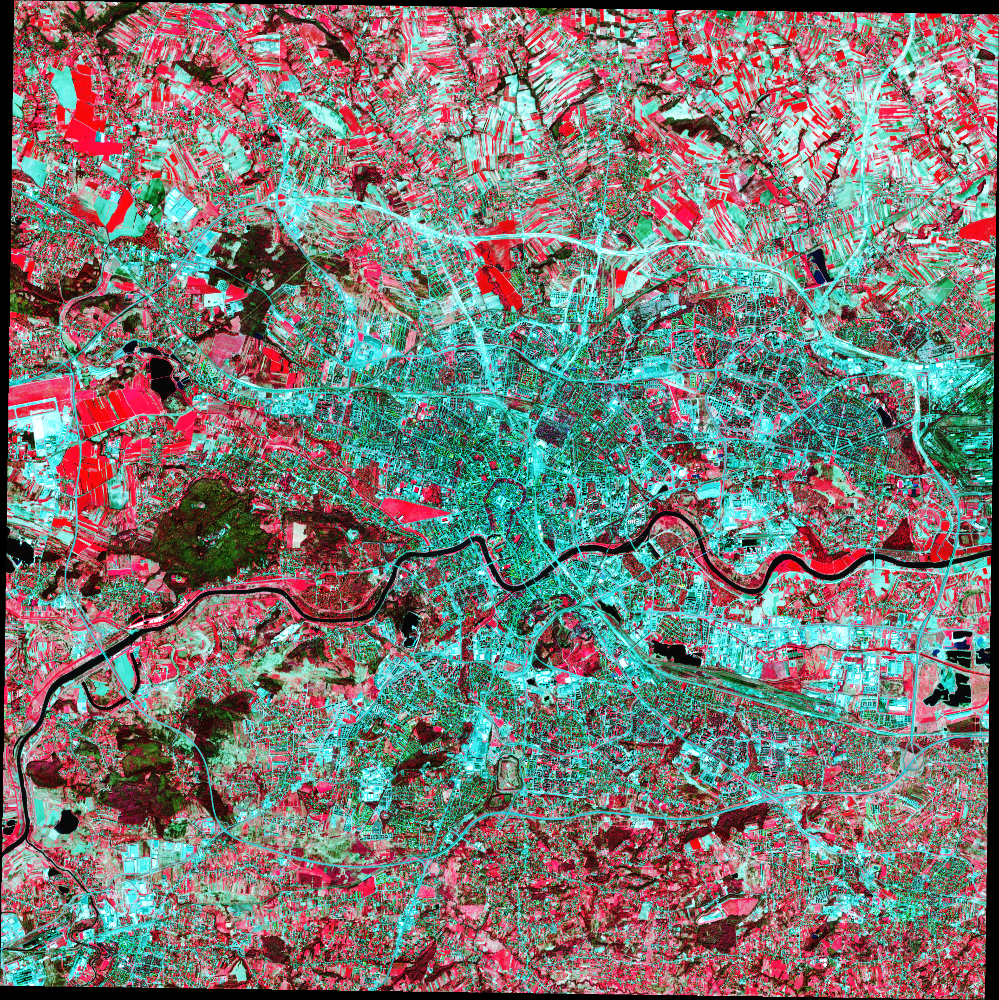

In [9]:
# fcc:
idx_fcc = [key_bands.index(name) for name in ('B08', 'B04', 'B03')]
print(f'bands idx: {idx_fcc}\n')

fcc = Image.fromarray(ars[:, :, idx_fcc])
fcc = equalize(fcc)
# plt.imshow(fcc);
fcc

# img to table

>- im -> 10 channels -> 10 cols (one-dimensional)
>- rows -> pixels number

In [10]:
ar.shape

(2152, 2151, 10)

In [11]:
data = np.reshape(ar, (-1, ar.shape[-1]))
data.shape

(4628952, 10)

In [12]:
data[:3, ...]

array([[0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]], dtype=uint16)

In [13]:
np.unique(data)

array([    0,     1,    89, ..., 19200, 19216, 19248], dtype=uint16)

## data_scaled

In [14]:
scaler = MinMaxScaler()
scaler.fit(data)
MinMaxScaler()
data_scaled = scaler.transform(data)

print(data.min(), data.max())
print(data_scaled.min(), data_scaled.max())

0 19248
0.0 1.0


# KMeans

## Default cluster number

In [15]:
kmn = KMeans(n_init=1).fit(data)

In [16]:
kmn.labels_.shape, data.shape, ar.shape

((4628952,), (4628952, 10), (2152, 2151, 10))

In [17]:
res = kmn.labels_.reshape(*ar.shape[:2])
res.shape, res.dtype, res.min(), res.max()

((2152, 2151), dtype('int32'), 0, 7)

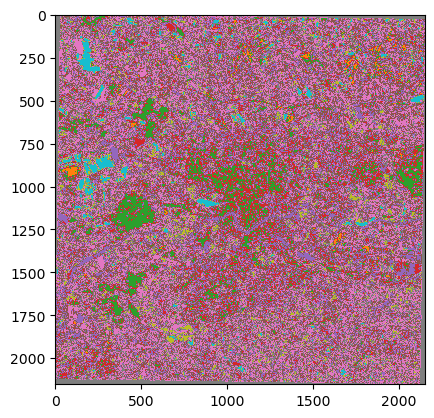

In [18]:
plt.imshow(res, vmax=8, cmap=plt.cm.tab10_r)

In [19]:
kmn.inertia_

3525279908710.8945

## elbow method

In [20]:
 def elbow(c, data, verb=False):
    res = []
    for k in c:
        kmeans = KMeans(n_clusters=k, n_init=1, random_state=0).fit(data)
        res.append((k, kmeans.inertia_))
        
    return res
    
res = elbow(list(range(2, 12)), data, True)

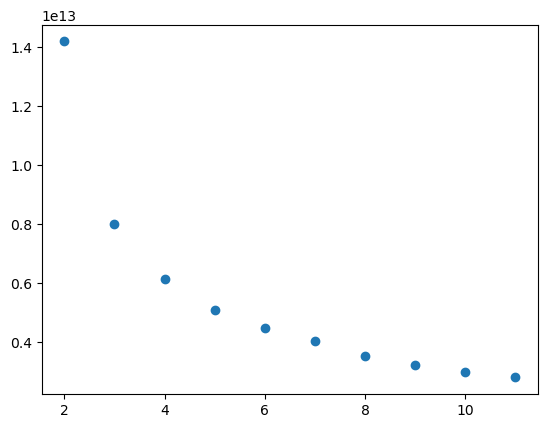

In [21]:
x, dist = list(zip(*res))
plt.scatter(x, dist)

## kmn_img: 6 clusters

In [22]:
# for 6 clusters
kmn = KMeans(n_clusters=6, n_init=1).fit(data)
kmn_img = kmn.labels_.reshape(*ar.shape[:2])

(-0.5, 2150.5, 2151.5, -0.5)

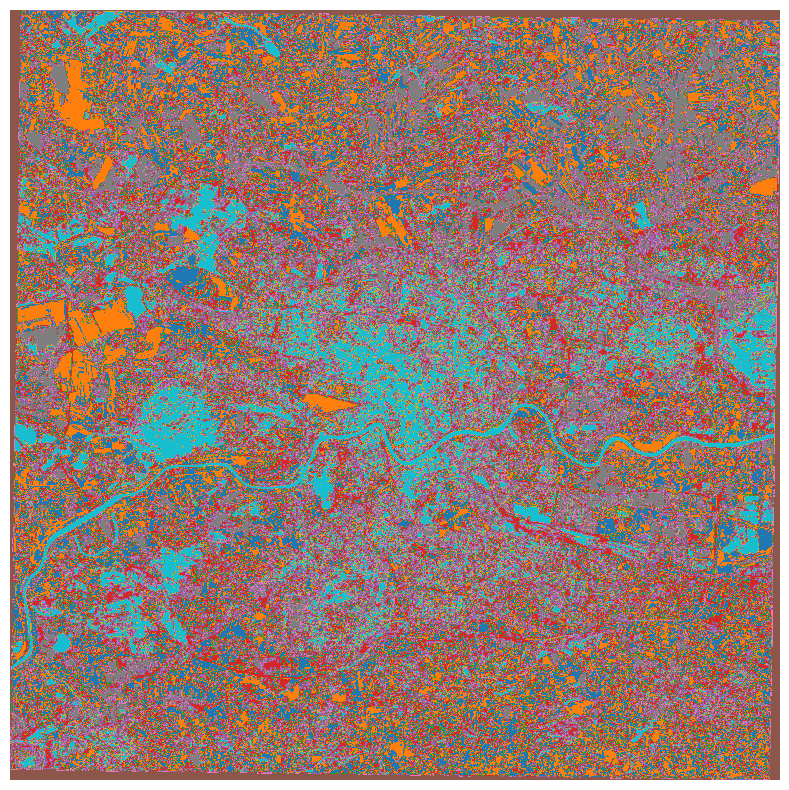

In [23]:
f = plt.figure(figsize=(10,10))
plt.imshow(kmn_img, cmap=plt.cm.tab10_r)
plt.axis('off')

# Random forest

## labelme
Prepare annotation using:
>- `labelme` - Image Polygonal Annotation with Python
>- https://github.com/wkentaro/labelme

*Instalation*
>- conda create -n labelme
>- conda activate labelme
>- conda install -c conda-forge pip
>- pip install pyside6 labelme

## mkdir rfc_data

In [24]:
!mkdir sentinel_im\rfc_data

A subdirectory or file sentinel_im\rfc_data already exists.


In [25]:
ls sentinel_im\rfc_data\

 Volume in drive C has no label.
 Volume Serial Number is 1699-49CC

 Directory of C:\img_proc_2023\sentinel_im\rfc_data

05/25/2023  09:52 AM    <DIR>          .
05/24/2023  07:07 PM    <DIR>          ..
05/25/2023  12:36 PM         4,982,749 img.png
05/25/2023  12:36 PM             8,314 label.png
05/25/2023  12:36 PM                67 label_names.txt
05/25/2023  12:36 PM         1,891,505 label_viz.png
05/25/2023  12:36 PM         6,669,877 rgb.json
05/25/2023  12:44 PM         8,924,166 rgb.png
               6 File(s)     22,476,678 bytes
               2 Dir(s)  15,817,773,056 bytes free


## Save rgb image

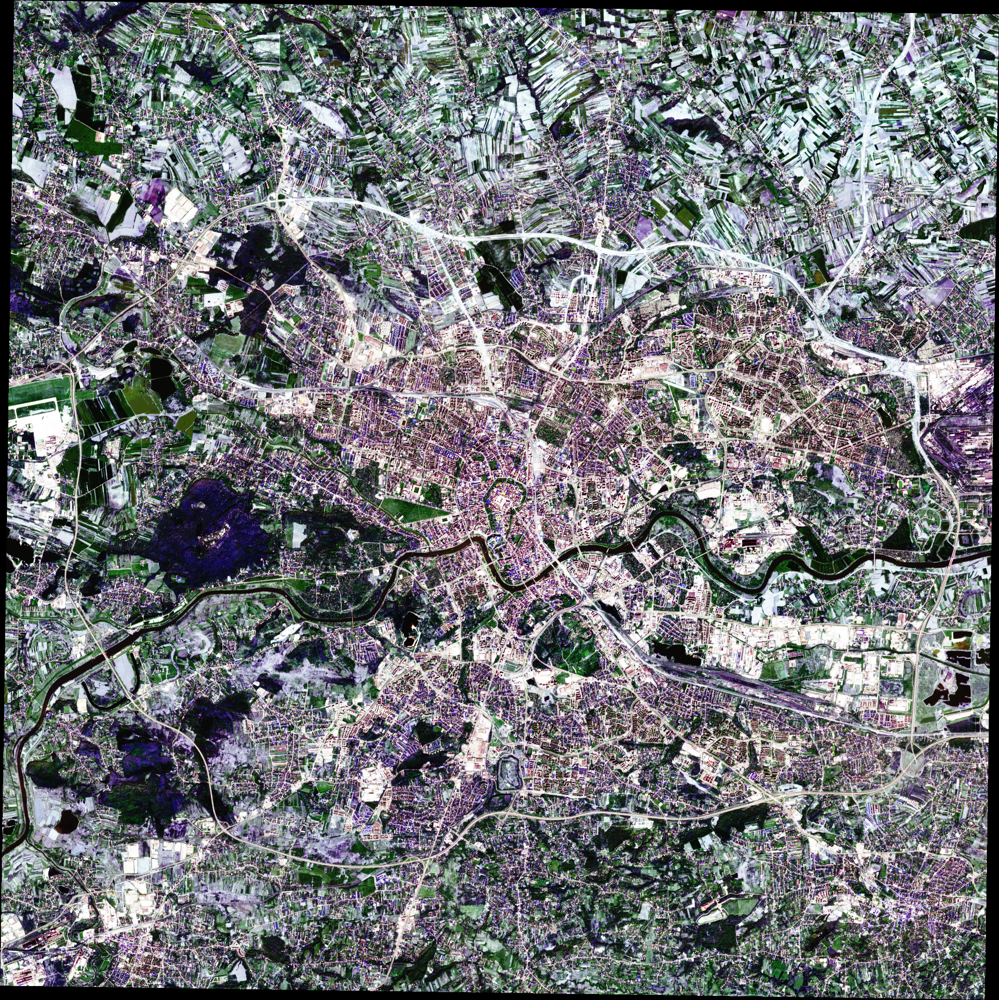

In [26]:
rgb = Image.fromarray(ars[:, :, idx_rgb[::-1]])
rgb = equalize(rgb)
rgb.save('sentinel_im/rfc_data/rgb.png')
rgb

In [27]:
ls sentinel_im\rfc_data\

 Volume in drive C has no label.
 Volume Serial Number is 1699-49CC

 Directory of C:\img_proc_2023\sentinel_im\rfc_data

05/25/2023  09:52 AM    <DIR>          .
05/24/2023  07:07 PM    <DIR>          ..
05/25/2023  12:36 PM         4,982,749 img.png
05/25/2023  12:36 PM             8,314 label.png
05/25/2023  12:36 PM                67 label_names.txt
05/25/2023  12:36 PM         1,891,505 label_viz.png
05/25/2023  12:36 PM         6,669,877 rgb.json
05/25/2023  01:37 PM         8,924,166 rgb.png
               6 File(s)     22,476,678 bytes
               2 Dir(s)  15,817,773,056 bytes free


## Show mask

(-0.5, 2150.5, 2151.5, -0.5)

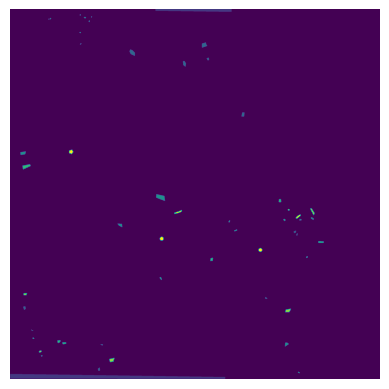

In [28]:
ad_mask = 'sentinel_im/rfc_data/label.png'
mask = np.array(Image.open(ad_mask))
plt.imshow(mask)
plt.axis('off')

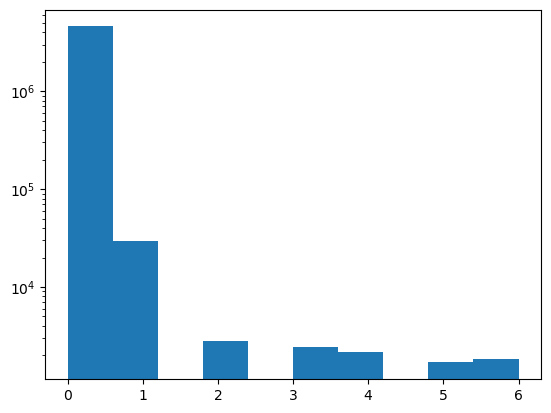

In [29]:
plt.hist(mask.ravel(), log=True);

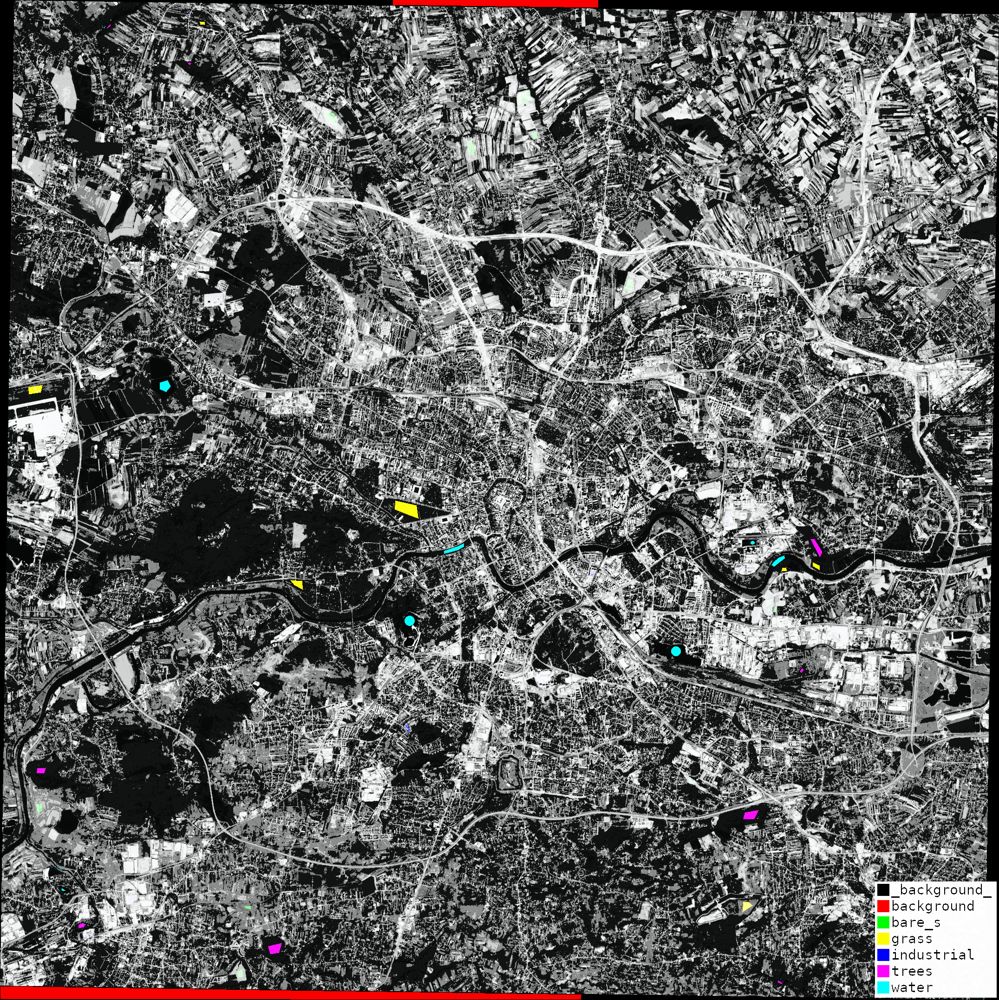

In [30]:
ad_viz = 'sentinel_im/rfc_data/label_viz.png'
im_viz = Image.open(ad_viz)
im_viz = equalize(im_viz)
im_viz

## class_id

In [31]:
class_id = np.unique(mask)
class_id = class_id[class_id > 0]
class_id

array([1, 2, 3, 4, 5, 6], dtype=uint8)

## mask to table

In [32]:
mask_table = np.reshape(mask, (-1, 1))
mask_table.shape

(4628952, 1)

## rows idx
>which rows contain pixels marked with class numbers?

In [33]:
idx = np.isin(mask_table, class_id).ravel()
idx.shape

(4628952,)

## labels from mask table

In [34]:
labels = mask_table[idx].ravel()
print(f'shape: {labels.shape}\n')
np.unique(labels)

shape: (40711,)



array([1, 2, 3, 4, 5, 6], dtype=uint8)

## train data
> All pixels assigned a class (from selected polygons in the image)

In [35]:
train_data = data_scaled[idx]
print(train_data.shape)
train_data[0, ...]

(40711, 10)


array([0., 0., 0., 0., 0., 0., 0., 0., 0., 0.])

## RandomForestClassifier()

In [36]:
clf = RandomForestClassifier()
clf.fit(train_data, labels)

RandomForestClassifier()

In [37]:
rfc_res = clf.predict(data_scaled)

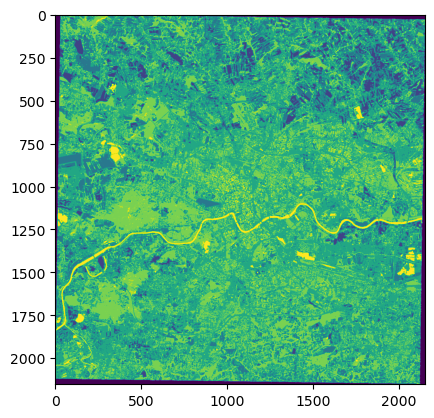

In [38]:
rfc_img = np.reshape(rfc_res, ar.shape[:2])
plt.imshow(rfc_img)

# Comparision

> kmn_img <-> rfc_img

## Cmaps
> base on: https://matplotlib.org/stable/gallery/color/custom_cmap.html

(-0.5, 2150.5, 2151.5, -0.5)

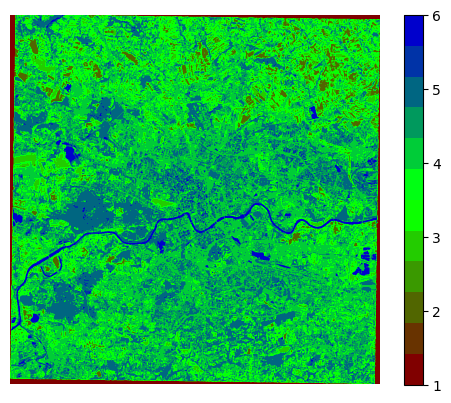

In [61]:
colors = [(0.5, 0, 0), (0, 1.1, 0), (0, 0, 0.8)]  # R -> G -> B
n_bins = len(class_id)+ 6 # Discretizes the interpolation into bins
cmap_name = 'my_list'

cmap = LinearSegmentedColormap.from_list(cmap_name, colors, N=n_bins)
im = plt.imshow(rfc_img, cmap=cmap)
plt.colorbar()
plt.axis('off')

(-0.5, 2150.5, 2151.5, -0.5)

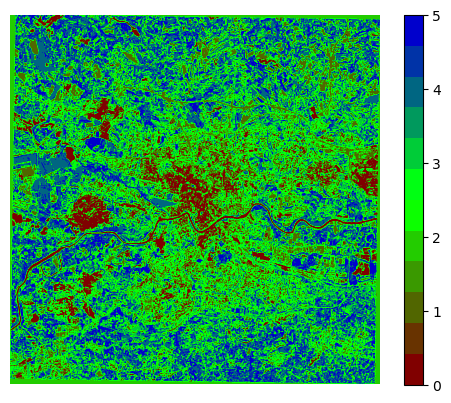

In [62]:
im = plt.imshow(kmn_img, cmap=cmap)
plt.colorbar()
plt.axis('off')